In [ ]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

np.random.seed(49)

## Download and Prepare the Dataset

We will use the <a href="https://public.roboflow.com/object-detection/vehicles-openimages" target="_blank">Vehicles-OpenImages</a> dataset for training the custom YOLOv5 object detector.

Let's download the dataset.

In [ ]:
!curl -L "https://public.roboflow.com/ds/xKLV14HbTF?key=aJzo7msVta" > roboflow.zip
!unzip roboflow.zip 
!rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   893  100   893    0     0   3408      0 --:--:-- --:--:-- --:--:--  3395
100 38.4M  100 38.4M    0     0  18.9M      0  0:00:02  0:00:02 --:--:-- 36.5M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/00dea1edf14f09ab_jpg.rf.3f17c8790a68659d03b1939a59ccda80.jpg  
 extracting: test/images/00dea1edf14f09ab_jpg.rf.KJ730oDTFPdXdJxvSLnX.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.6e6a8b3b45c9a11d106958f88ff714ea.jpg  
 extracting: test/images/00e481ea1a520175_jpg.rf.MV6sZ8QCFwFeMYaI2tHm.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.7IkYAamjZhnwsoXSrwKt.jpg  
 extracting: test/images/08c8b73e0c2e296e_jpg.rf.effa65856584463c08848031cab357b9.jpg  
 extractin

In [ ]:
len(glob.glob('train/images/*.jpg')), len(glob.glob('valid/images/*.jpg')), len(glob.glob('test/images/*.jpg'))

(878, 250, 126)

In [ ]:
for i, dir_name in enumerate(['train', 'valid', 'test']):
    all_image_names = sorted(os.listdir(f"{dir_name}/images/"))
    
    # Delete duplicate images and labels. Every image is duplicate twice
    for j, image_name in enumerate(all_image_names):
        if (j % 2) == 0:
            file_name = image_name.split('.jpg')[0]
            os.remove(f"{dir_name}/images/{image_name}")
            os.remove(f"{dir_name}/labels/{file_name}.txt")

In [ ]:
len(glob.glob('train/images/*.jpg')), len(glob.glob('valid/images/*.jpg')), len(glob.glob('test/images/*.jpg'))

(439, 125, 63)

### Visualize a Few Ground Truth Images

Before moving forward, let's check out few of the ground truth images. 

The current annotations in the text files are in normalized `[x_center, y_center, width, height]` format. Let's write a function that will convert it back to `[x_min, y_min, x_max, y_max]` format.

In [ ]:
class_names = ['Ambulance', 'Bus', 'Car', 'Motorcycle', 'Truck']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [ ]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax 

In [ ]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax),color=colors[class_names.index(class_name)],thickness=2) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(class_name, 0, fontScale=font_scale, thickness=font_thickness)[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle( image,  p1, p2, color=colors[class_names.index(class_name)], thickness=-1)
        cv2.putText( image,  class_name, (xmin+1, ymin-10), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (255, 255, 255), font_thickness)
    return image

In [ ]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = sorted(glob.glob(image_paths))
    all_training_labels = sorted(glob.glob(label_paths))
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, num_samples//2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

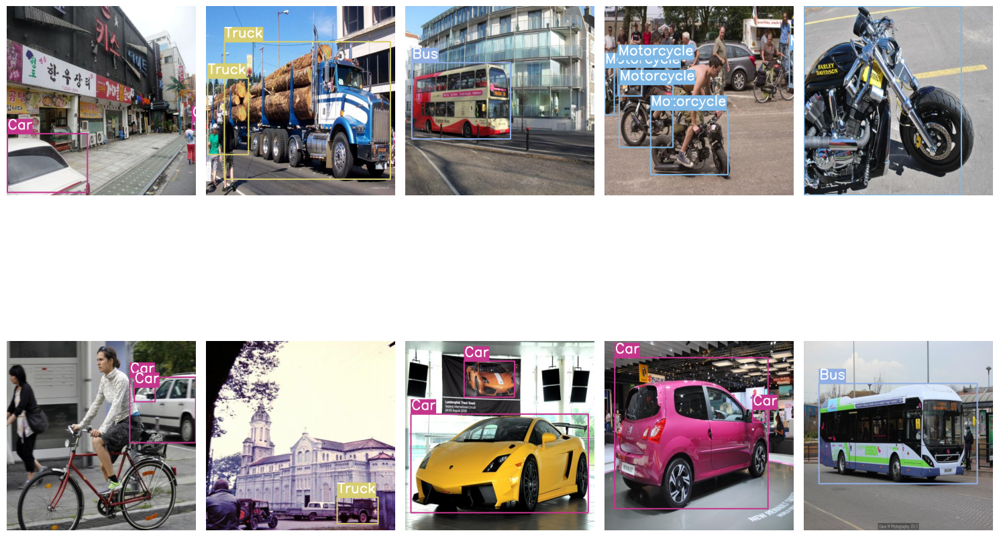

In [ ]:
# Visualize a few training images.
plot(image_paths='train/images/*',  label_paths='train/labels/*', num_samples=10)

## Clone YOLOV5 Repository

In [ ]:
!git clone https://github.com/ultralytics/yolov5.git

Cloning into 'yolov5'...
remote: Enumerating objects: 15637, done.
remote: Counting objects: 100% (244/244), done.
remote: Compressing objects: 100% (144/144), done.
remote: Total 15637 (delta 123), reused 173 (delta 100), pack-reused 15393
Receiving objects: 100% (15637/15637), 14.58 MiB | 2.66 MiB/s, done.
Resolving deltas: 100% (10652/10652), done.


In [ ]:
%cd yolov5/
!pwd

/content/yolov5
/content/yolov5


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.9 MB/s eta 0:00:00


# **Run-1 of Object Detection**

In [ ]:
EPOCHS = 40
RES_DIR = 'run_1'

In [ ]:
!python train.py --data ../data.yaml --weights yolov5s.pt --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=run_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=

## Check Out the Validation Predictions and Inference

In this section, we will check out the predictions of the validation images saved during training. Along with that, we will also check out inference of images and videos.

### Visualization and Inference Utilities

We will visualize the validation prediction images that are saved during training. The following is the function for that.

In [ ]:
!pwd

/content/yolov5


In [ ]:
!ls runs/train/{RES_DIR}

confusion_matrix.png				    results.png
events.out.tfevents.1683302109.4b85572ad5ad.3477.0  train_batch0.jpg
F1_curve.png					    train_batch1.jpg
hyp.yaml					    train_batch2.jpg
labels_correlogram.jpg				    val_batch0_labels.jpg
labels.jpg					    val_batch0_pred.jpg
opt.yaml					    val_batch1_labels.jpg
P_curve.png					    val_batch1_pred.jpg
PR_curve.png					    val_batch2_labels.jpg
R_curve.png					    val_batch2_pred.jpg
results.csv					    weights


**Visualize validation prediction images.**

['runs/train/run_1/val_batch1_pred.jpg', 'runs/train/run_1/val_batch0_pred.jpg', 'runs/train/run_1/val_batch2_pred.jpg']


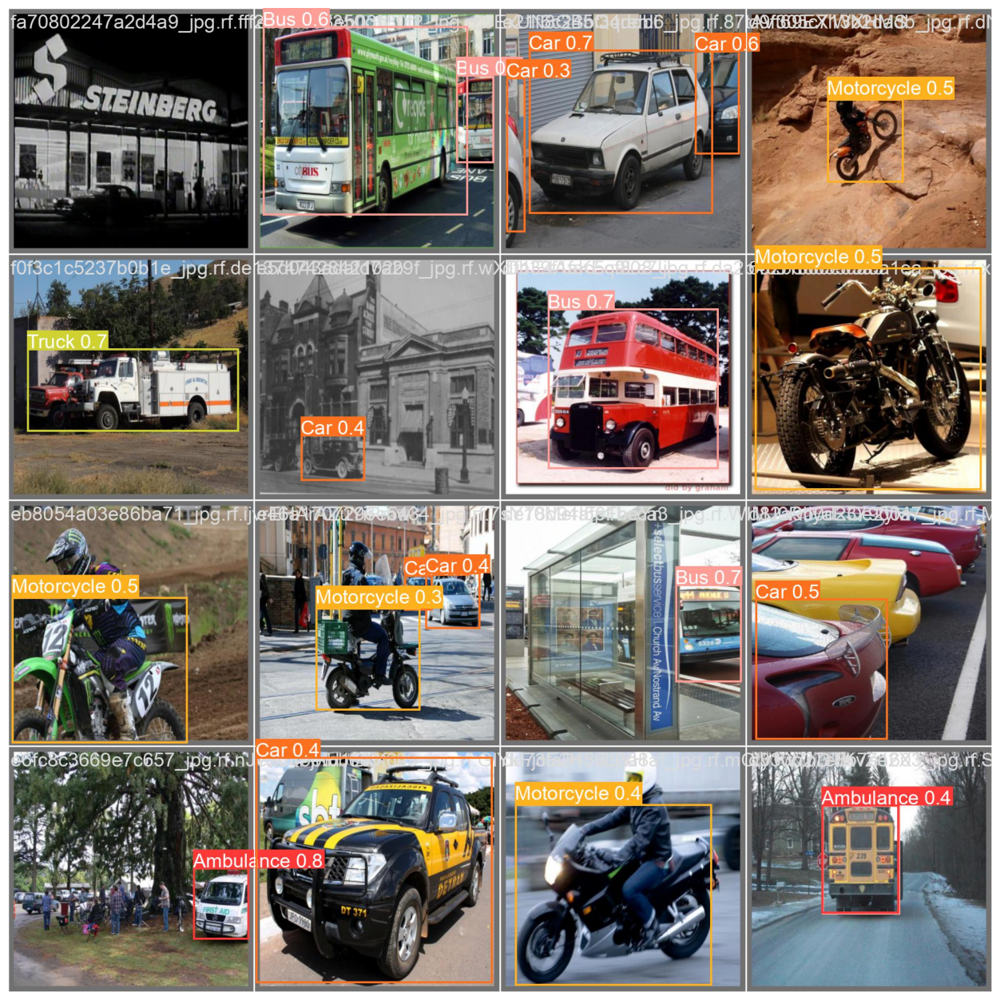

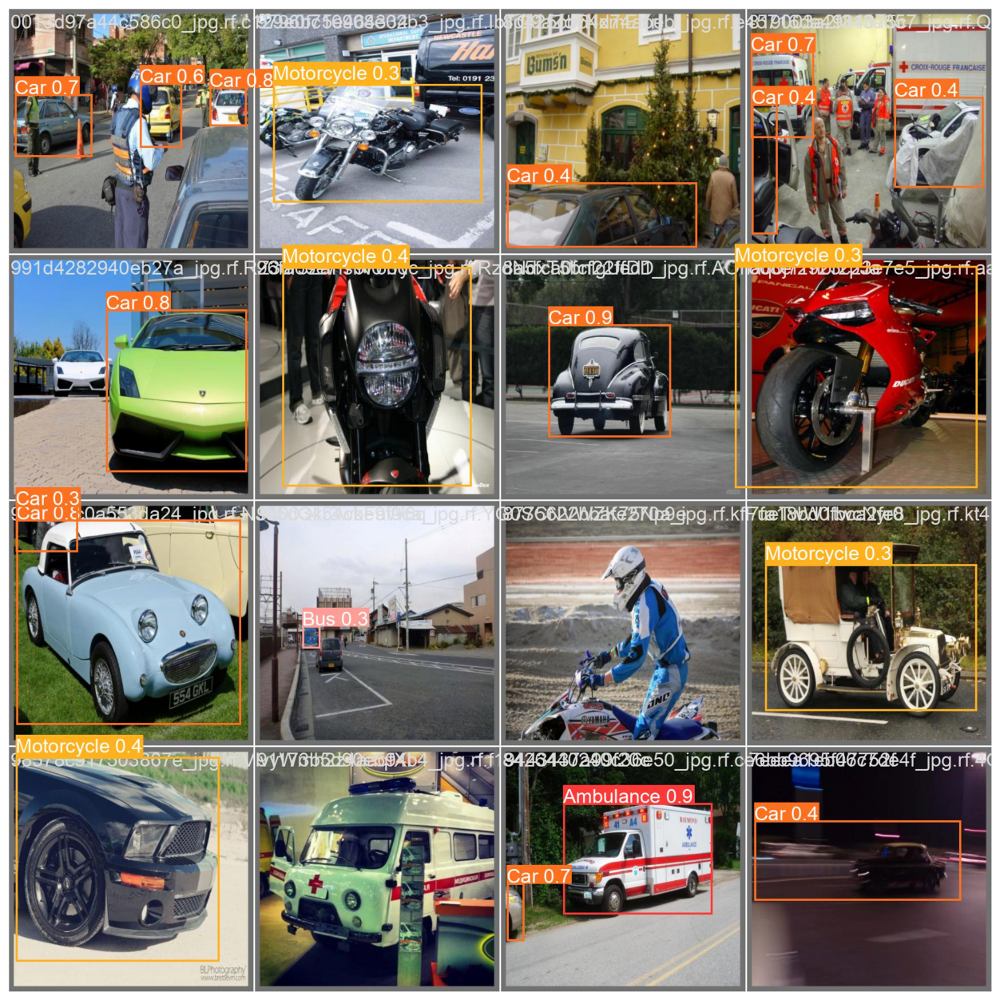

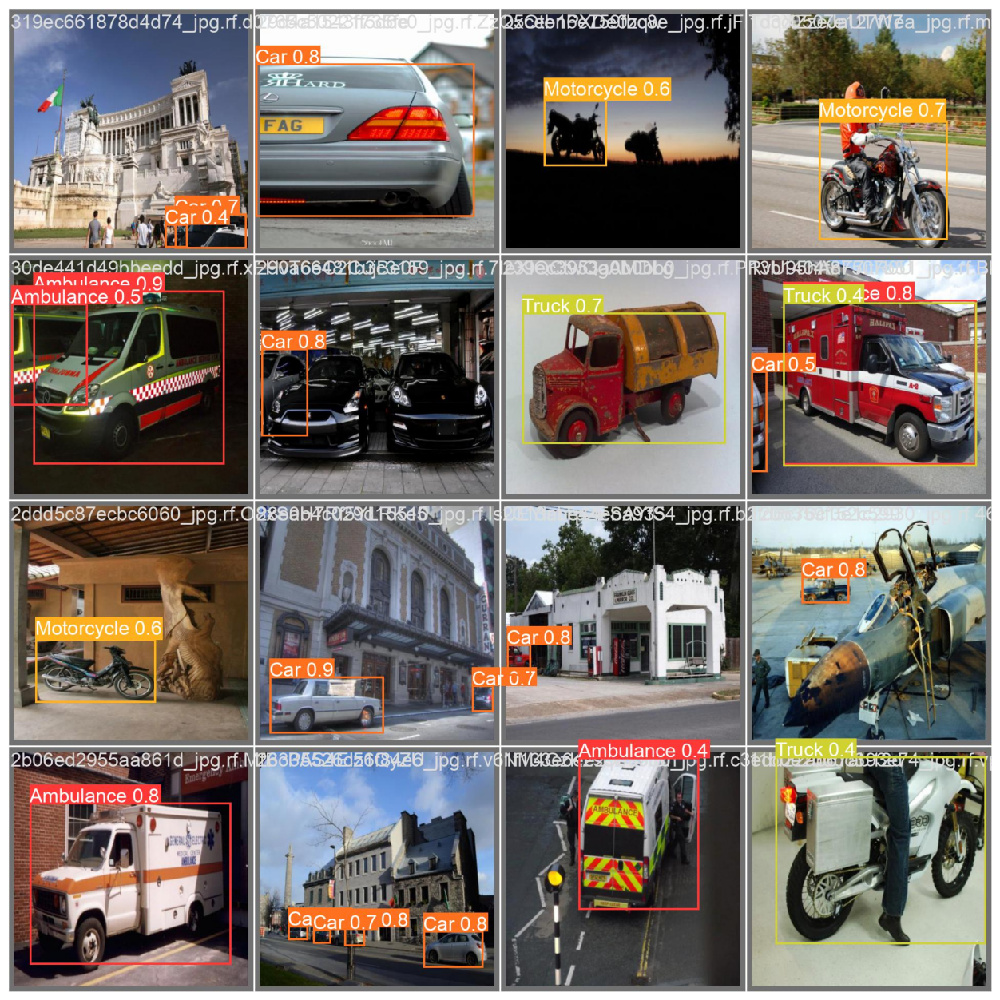

In [ ]:
validation_pred_images = glob.glob(f"runs/train/{RES_DIR}/*_pred.jpg")
print(validation_pred_images)
for pred_image in validation_pred_images:
    image = cv2.imread(pred_image)
    plt.figure(figsize=(19, 16))
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

### **Inference**
In this section, we will carry out inference on unseen images and videos from the internet. 

The images for inference are in the `inference_images` directory.

The videos for inference are in the `inference_videos` directory.

### Download the Images and Videos
Let's download the images and videos that we will carry inference upon.

In [39]:
url = 'https://learnopencv.s3.us-west-2.amazonaws.com/yolov5_inference_data.zip'
save_name = 'inference_data.zip'
file = requests.get(url)
open(save_name, 'wb').write(file.content)
!unzip -q "inference_data.zip"

replace inference_images/image_1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: A


Performing inference on images and videos.

In [40]:
image_res_dir = 'image_results' 
 
!python detect.py --weights runs/train/{RES_DIR}/weights/best.pt --source {'inference_images'} --name {image_res_dir}

detect: weights=['runs/train/run_1/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=image_results, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/9 /content/yolov5/inference_images/image_1.jpg: 448x640 3 Cars, 1 Truck, 50.9ms
image 2/9 /content/yolov5/inference_images/image_2.jpg: 416x640 (no detections), 47.9ms
image 3/9 /content/yolov5/inference_images/image_3.jpg: 448x640 1 Bus, 1 Motorcycle, 8.9ms
image

In [41]:
video_res_dir = 'video_results'

!python detect.py --weights runs/train/{RES_DIR}/weights/best.pt --source {'inference_videos'} --name {video_res_dir}

detect: weights=['runs/train/run_1/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=video_results, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
video 1/5 (1/1260) /content/yolov5/inference_videos/project_video.mp4: 384x640 (no detections), 46.5ms
video 1/5 (2/1260) /content/yolov5/inference_videos/project_video.mp4: 384x640 (no detections), 7.9ms
video 1/5 (3/1260) /content/yolov5/inference_videos/project_video.m

Visualize inference image results in any of the directories.

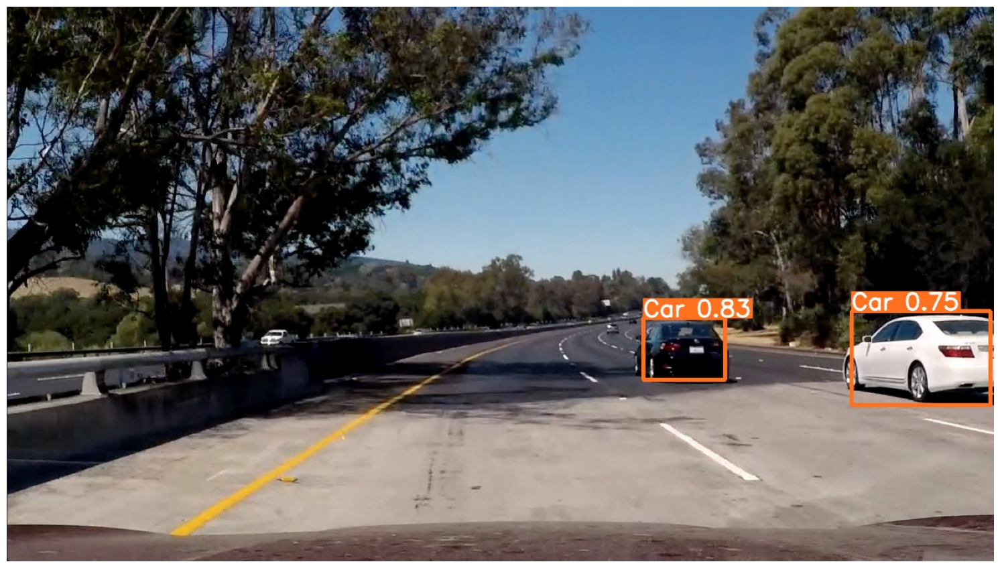

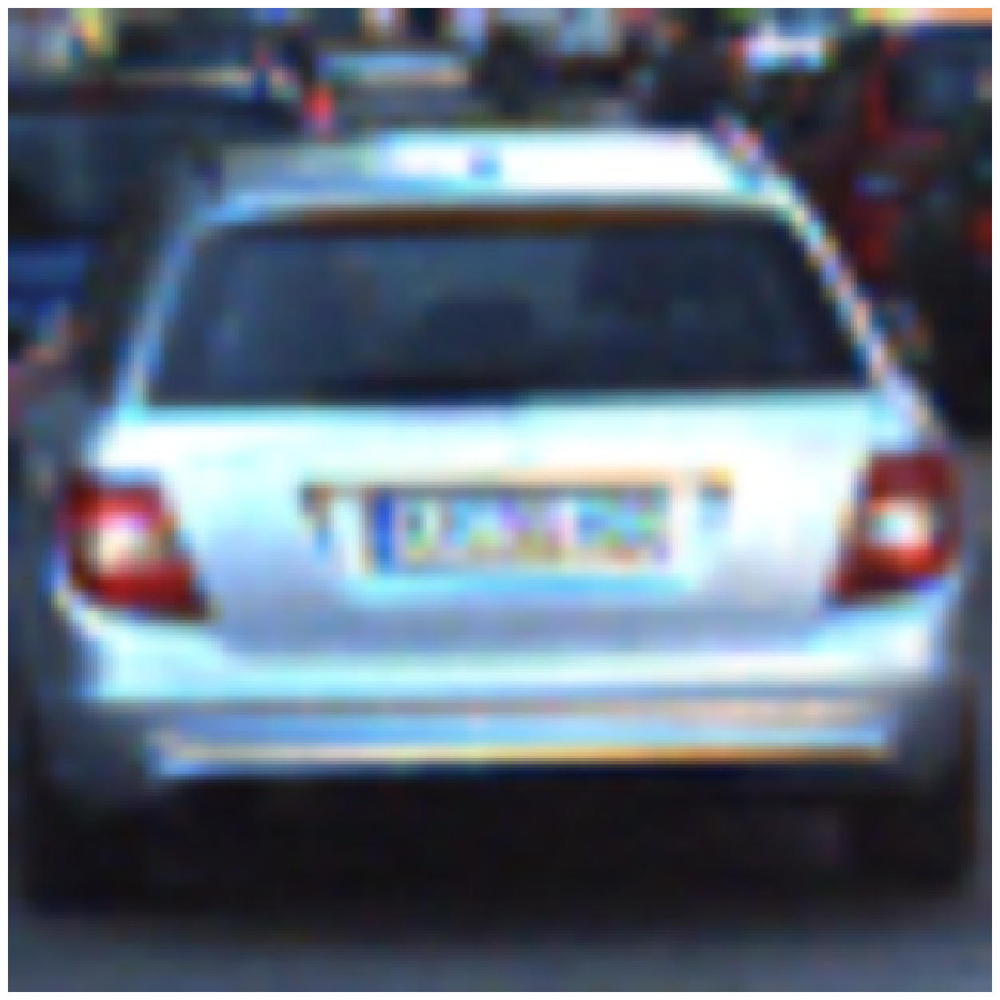

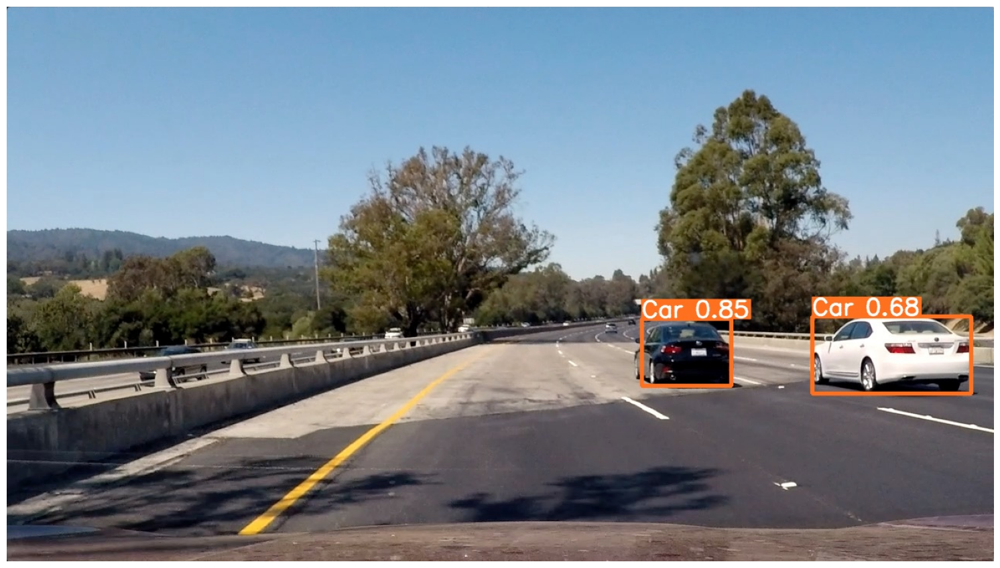

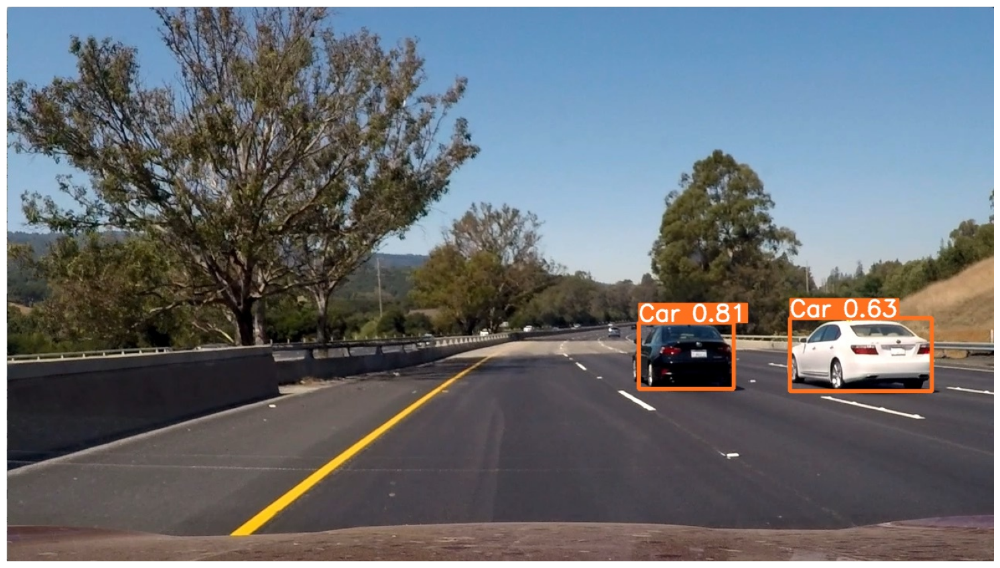

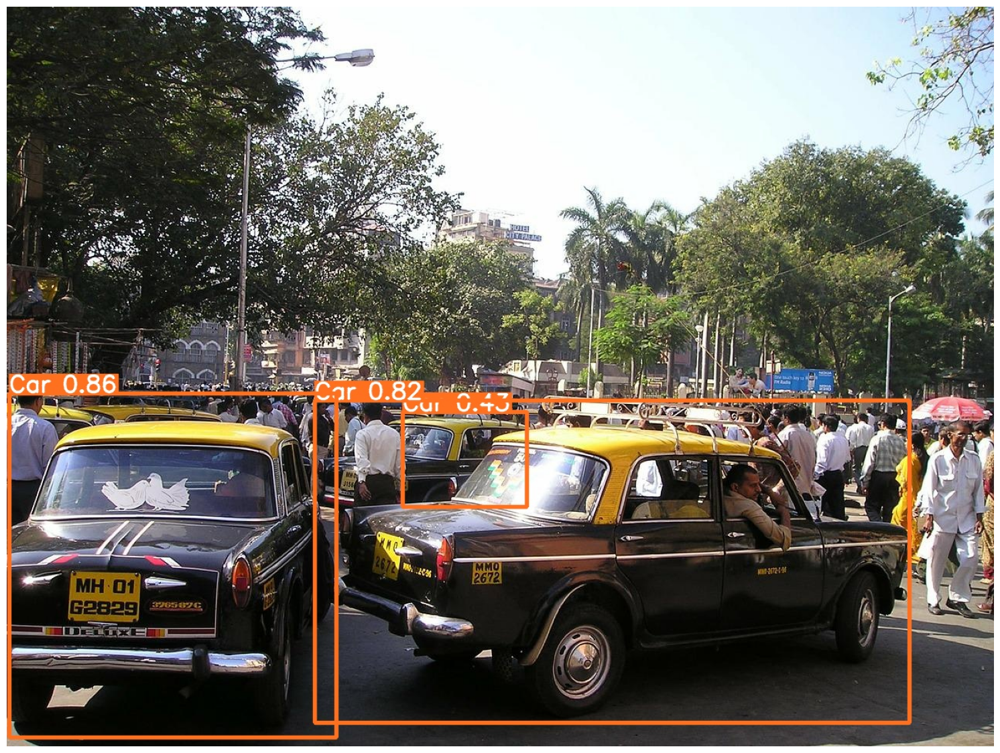

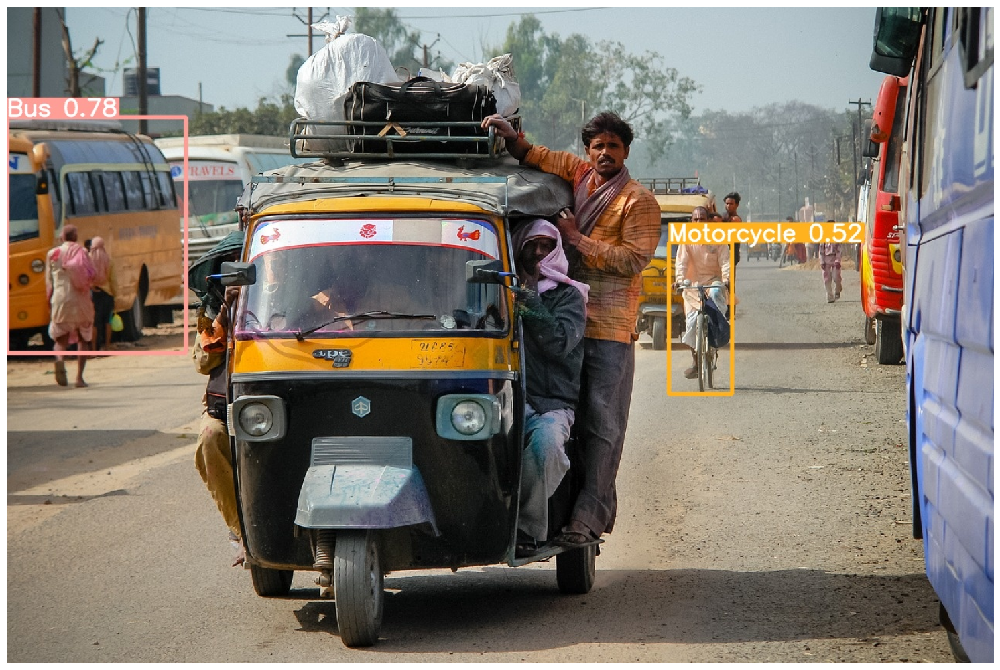

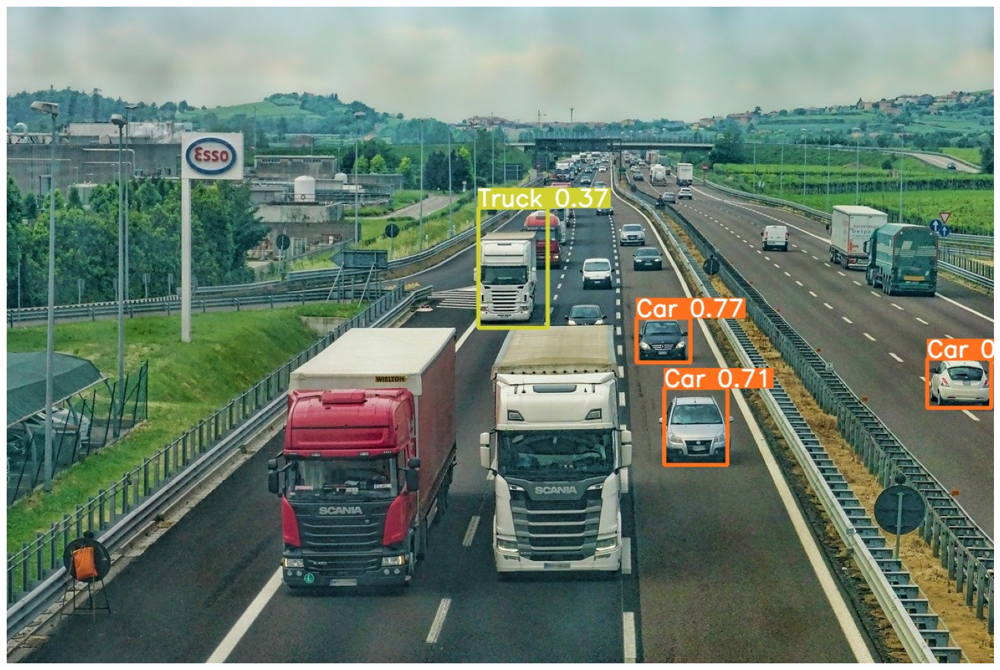

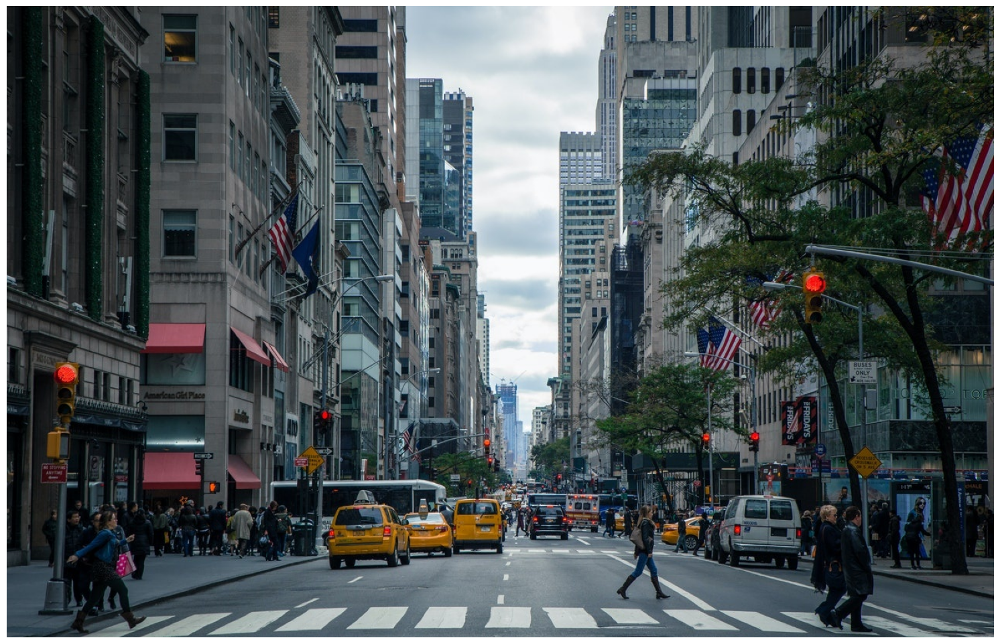

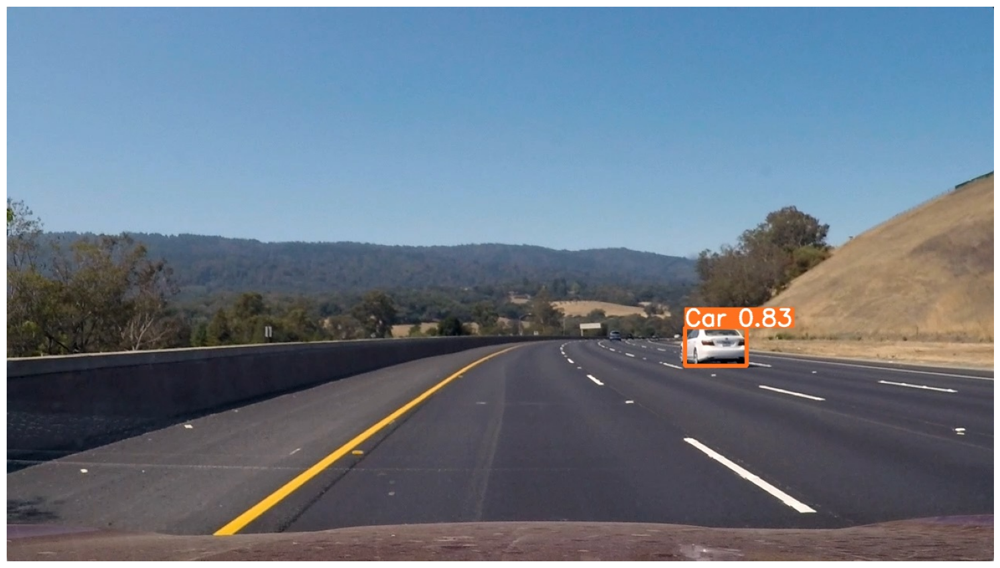

In [43]:
# Visualize inference images.
infer_images = glob.glob(f"runs/detect/image_results/*.jpg")
for pred_image in infer_images:
    image = cv2.imread(pred_image)
    plt.figure(figsize=(19, 16))
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

# **Run-2 of Object Detection**

In [44]:
EPOCHS = 40
RES_DIR = 'run_2'

In [45]:
!python train.py --data ../data.yaml --weights yolov5s.pt --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR}

train: weights=yolov5s.pt, cfg=, data=../data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=run_2, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=

**Visualize validation prediction images.**

['runs/train/run_2/val_batch1_pred.jpg', 'runs/train/run_2/val_batch0_pred.jpg', 'runs/train/run_2/val_batch2_pred.jpg']


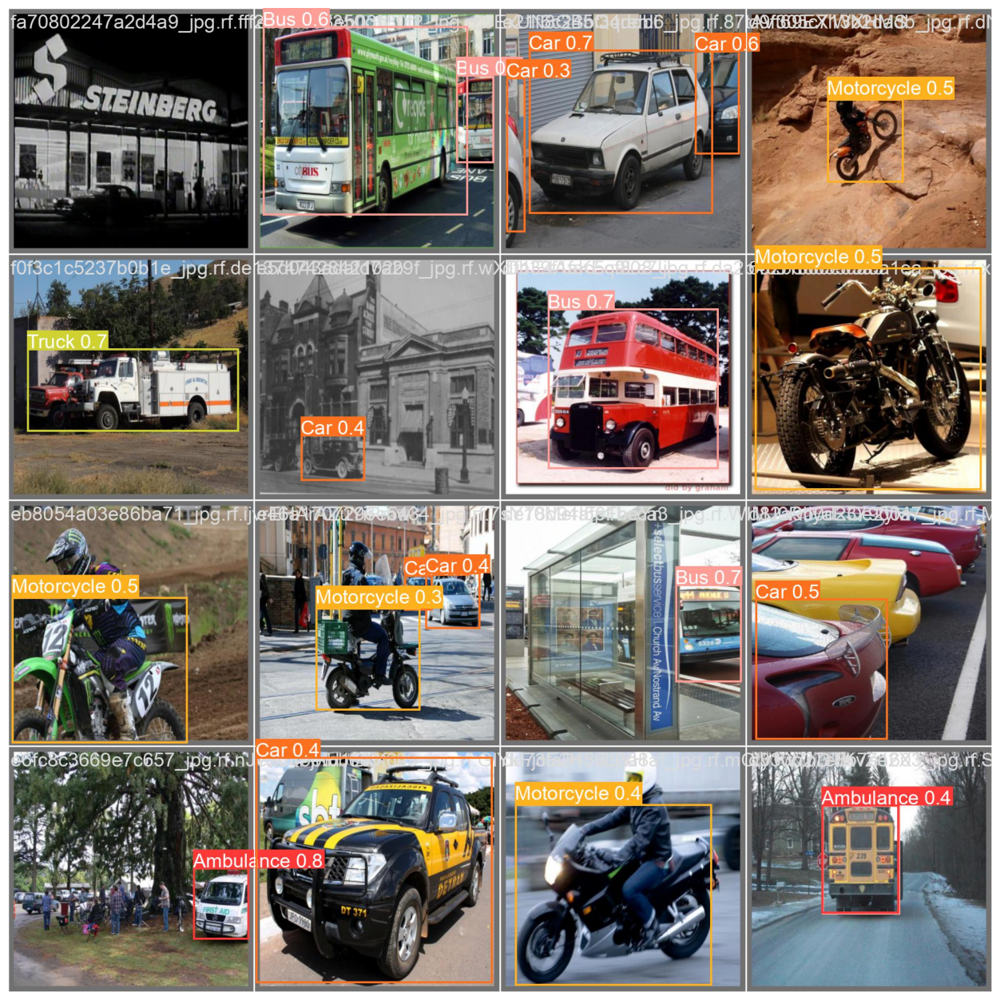

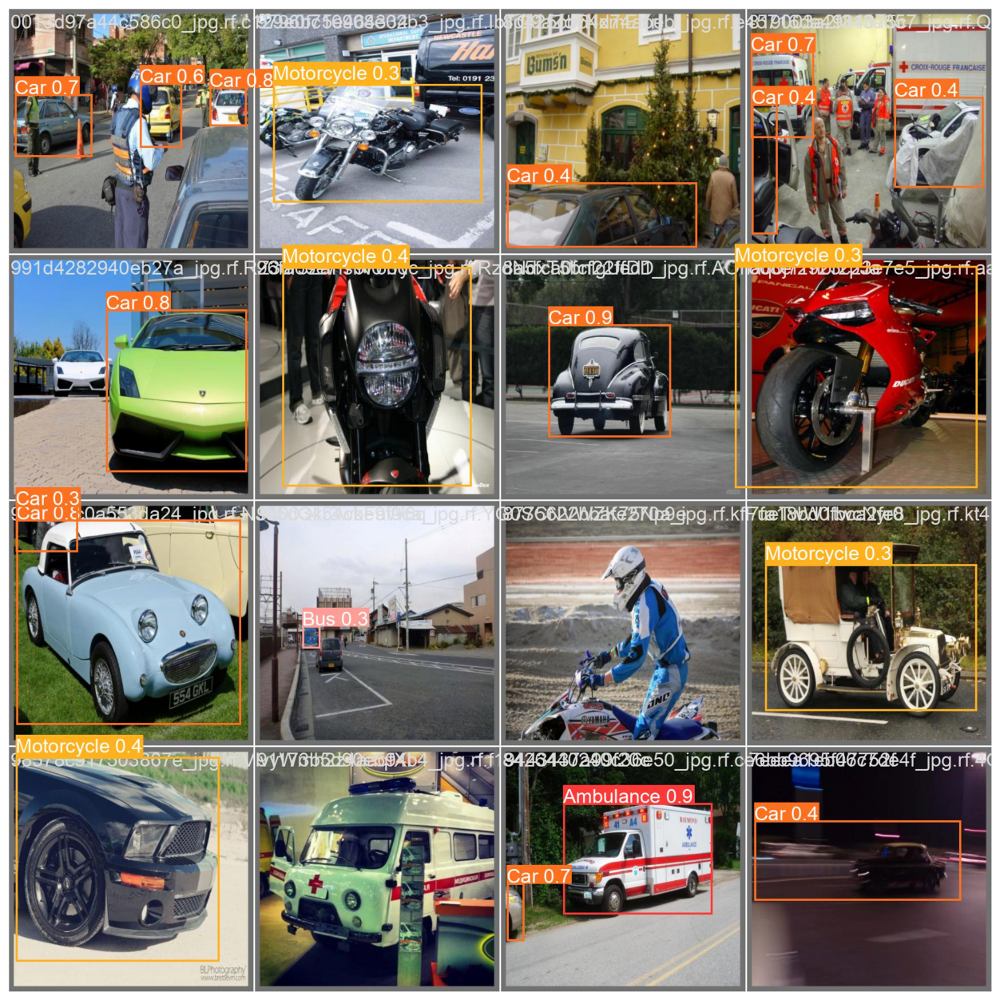

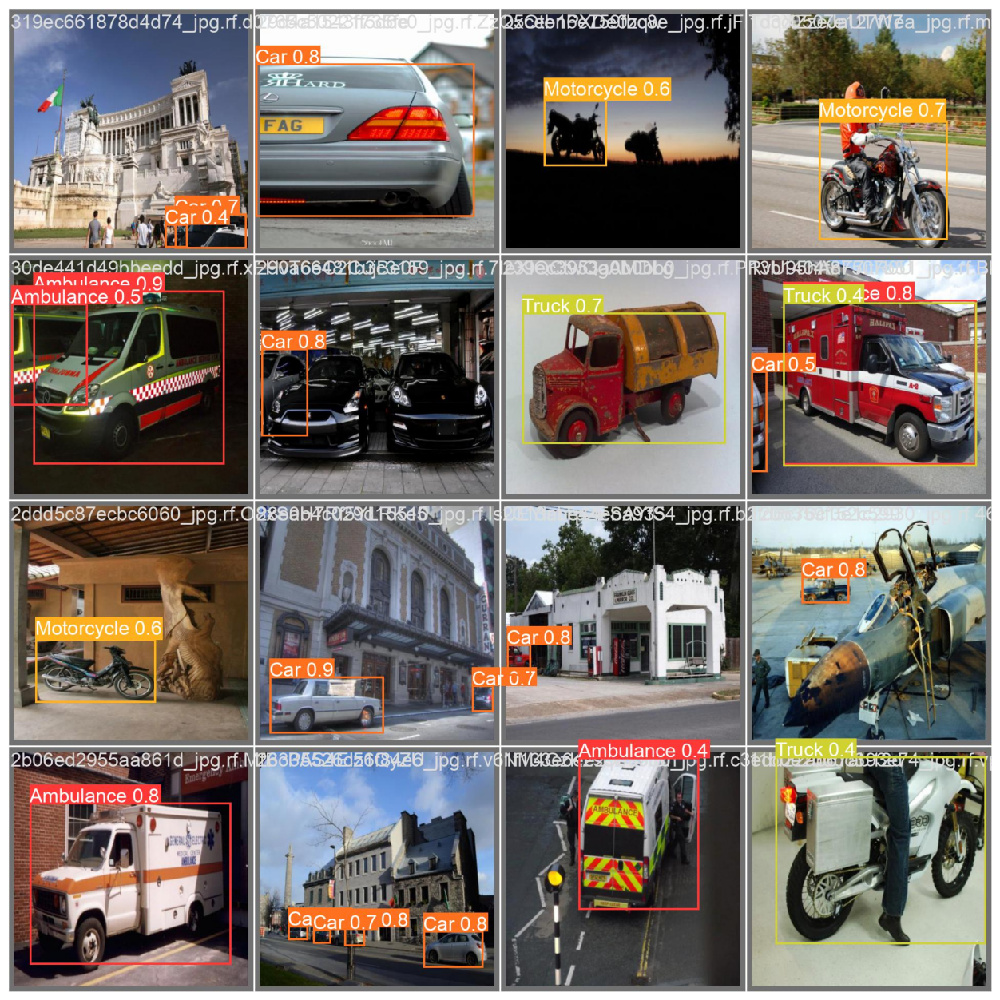

In [46]:
validation_pred_images = glob.glob(f"runs/train/{RES_DIR}/*_pred.jpg")
print(validation_pred_images)
for pred_image in validation_pred_images:
    image = cv2.imread(pred_image)
    plt.figure(figsize=(19, 16))
    plt.imshow(image[:, :, ::-1])
    plt.axis('off')
    plt.show()

Performing inference on images and videos.

In [47]:
image_res_dir = 'image_results_run2' 
 
!python detect.py --weights runs/train/{RES_DIR}/weights/best.pt --source {'inference_images'} --name {image_res_dir}

detect: weights=['runs/train/run_2/weights/best.pt'], source=inference_images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=image_results_run2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/9 /content/yolov5/inference_images/image_1.jpg: 448x640 3 Cars, 1 Truck, 45.9ms
image 2/9 /content/yolov5/inference_images/image_2.jpg: 416x640 (no detections), 45.2ms
image 3/9 /content/yolov5/inference_images/image_3.jpg: 448x640 1 Bus, 1 Motorcycle, 8.9ms


In [48]:
video_res_dir = 'video_results_run2'

!python detect.py --weights runs/train/{RES_DIR}/weights/best.pt --source {'inference_videos'} --name {video_res_dir}

detect: weights=['runs/train/run_2/weights/best.pt'], source=inference_videos, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=video_results_run2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
requirements: /content/requirements.txt not found, check failed.
YOLOv5 🚀 v7.0-162-gc3e4e94 Python-3.10.11 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
video 1/5 (1/1260) /content/yolov5/inference_videos/project_video.mp4: 384x640 (no detections), 52.3ms
video 1/5 (2/1260) /content/yolov5/inference_videos/project_video.mp4: 384x640 (no detections), 8.4ms
video 1/5 (3/1260) /content/yolov5/inference_videos/project_vi